This notebook is running with Python 3.6.

To run the notebook, please check if you have the following packages installed:

- pandas_profiling
- geopandas

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import re
import pandas_profiling
import geopandas as gpd
%matplotlib inline
%load_ext autoreload
%autoreload 2

# Load shapefile data

You can check http://geoplaza.vu.nl/data/dataset/postcode to look for postcode map of The Netherlands

In [2]:
sf = '../data/PC4_Nederland_2015.shp'

map_df_pc4 = gpd.read_file(sf)

Check how the geopandas dataframe looks like

In [3]:
map_df_pc4.head()

,PC4,pc4txt,pc4_naam,Shape_Leng,Shape_Area,geometry
0,1011.0,1011,1011 Nieuwmarkt/Lastage,5743.124944,1.031451e+06,"POLYGON ((122259.5323229181 487908.287093441, ..."
1,1012.0,1012,1012 Burgwallen,5530.160457,1.206651e+06,"POLYGON ((121842.799177191 488393.3480548903, ..."
2,1013.0,1013,1013 W havengebied/Westerpark/Haarlemmerbrt,23051.650018,6.341021e+06,"POLYGON ((120671.5850000111 493156.1720000198,..."
3,1014.0,1014,1014 Sloterdijk,13850.627656,2.698317e+06,(POLYGON ((120418.6527881862 489749.8191700127...
4,1015.0,1015,1015 Grachtengordel-W/Jordaan,4944.894539,7.754113e+05,"POLYGON ((121465.4800000259 488093.5930000092,..."


Let's make a new column to record the first 2 digits of the postal code. Later on, we will use it to aggregate the area size and polygons

In [4]:
map_df_pc4['PC2'] = map_df_pc4['PC4'].apply(lambda r: np.floor(r/100))

As we may not want to work with the map on very granular level, we can aggregate the geopandas dataframe by `dissolve` function, just as we do normal pandas aggregation by `groupby`

In [5]:
map_df_pc2 = map_df_pc4.dissolve(by='PC2', aggfunc='sum').reset_index(inplace=False)[['PC2', 'Shape_Area', 'geometry']]

The new geopandas dataframe looks like this

In [6]:
map_df_pc2.head()

,PC2,Shape_Area,geometry
0,10.0,1.892986e+08,"POLYGON ((129448.5859938612 484050.4601789143,..."
1,11.0,3.049541e+08,(POLYGON ((110637.9910000306 492537.7470000267...
2,12.0,1.538827e+08,"(POLYGON ((150087.2990000378 479382.379000009,..."
3,13.0,4.127193e+08,"(POLYGON ((129013.837913578 471577.0084978122,..."
4,14.0,3.366214e+08,"(POLYGON ((141615.828000008 476207.2240000192,..."


Let's define a plotting function for visualization purpose later on

In [7]:
def plot_on_map(dataframe, var, v_min, v_max, years, scheme='equal_interval', color='Blues', categorical=False):
    fig, axes = plt.subplots(3, 3, figsize=(50, 50))
    for ix, y in enumerate(years):
    #     df = df[df['PC2']==25]
        df = dataframe[dataframe['year']==y].copy()
        tmp_ax = axes[int(ix/3), ix%3]
        if categorical:
            df.plot(ax=tmp_ax, column=var, categorical=True, cmap='Paired', legend=True, figsize=(10, 6))
        else:
            df.plot(ax=tmp_ax, column=var, cmap=color, scheme=scheme)
            sm = plt.cm.ScalarMappable(cmap=color, norm=plt.Normalize(vmin=v_min, vmax=v_max))
            sm._A = []
            cbar = fig.colorbar(sm, ax=tmp_ax)
        tmp_ax.set_title("%s in NL in %s"%(var, years[ix]))
        tmp_ax.set_axis_off()
    fig.tight_layout()
    plt.show()

# Access the consumption data

First check the number of files in the folders

In [8]:
path_electricity = "../data/Electricity/"
path_gas = "../data/Gas/"
print("%s files in %s"%(len(os.listdir(path_electricity)), path_electricity))
print("%s files in %s"%(len(os.listdir(path_gas)), path_gas))

29 files in ../data/Electricity/
29 files in ../data/Gas/


In [9]:
def read_consumption_files(path):
    files_list = sorted(os.listdir(path))
    return {f.split('.')[0]: pd.read_csv(path+f) for f in files_list}

The consumption data contains the consumption for electricity and for gas. For this notebook we will look into the electricity part. First, let's read the electricity files.

In [10]:
electricity_files = read_consumption_files(path_electricity)

## Concatenate consumptions from the same company

The consumptions are provided by 3 companies (Enexis, Liander, Stedin), and are delivered to us in `company_year.csv` format. It's handy that we will concatenate the data from the same company.

In [11]:
companies = ['enexis', 'liander', 'stedin']
files = electricity_files.keys()

In [12]:
enexis = [f for f in files if re.search(companies[0], f)]
liander = [f for f in files if re.search(companies[1], f)]
stedin = [f for f in files if re.search(companies[2], f)]

In [13]:
def concatenate_same_company(electricity_files, company_file_list):
    dfs = []
    for f in company_file_list:
        df = electricity_files[f]
        df['year'] = int(f.split('_')[-1][-4:])
        dfs.append(df)
    return pd.concat(dfs, sort=False)

In [14]:
df_enexis = concatenate_same_company(electricity_files, enexis)
df_liander = concatenate_same_company(electricity_files, liander)
df_stedin = concatenate_same_company(electricity_files, stedin)

From the metadata, which we will see later, we know that the data is provided at the zipcode range level. We will do the same operation as we did to the geopandas dataframe to have the first 2 digits of the postal code in order to aggregate data to a higher level

In [15]:
def refactor_postal_code(df, n_digits):
    df['PC%s'%str(n_digits)] = df['zipcode_from'].apply(lambda r: int(r[:n_digits]))
    return df

In [16]:
ns = np.arange(1, 5)
for n in ns:
    df_enexis = refactor_postal_code(df_enexis, n)
    df_liander = refactor_postal_code(df_liander, n)
    df_stedin = refactor_postal_code(df_stedin, n)

In [17]:
df_enexis['net_manager_index'] = 'ENEXIS'
df_liander['net_manager_index'] = 'LIANDER'
df_stedin['net_manager_index'] = 'STEDIN'

## Merge dataframes of the same year

In the previous step, we have concatenated data from the same company. In this step we'd also merge data of the same year, and merge the yearly dataframe to one dataframe eventually. Later on we will filter on the merged dataframe to analyze the data.

Let's first look at for which years these companies were providing the consumption data.

In [18]:
enexis_years = df_enexis['year'].unique().tolist()
liander_years = df_liander['year'].unique().tolist()
stedin_years = df_stedin['year'].unique().tolist()

In [19]:
overlapping_years = sorted(list(set(enexis_years)&set(liander_years)&set(stedin_years)))
print("Overlapping years between companies are: %s"% \
      (' '.join([str(y) for y in overlapping_years])))

Overlapping years between companies are: 2010 2011 2012 2013 2014 2015 2016 2017 2018


Ok. Let's merge dataframes for these years.

In [20]:
def merge_df_year(dfs, year):
    dfs_year = [df[df['year']==year].copy() for df in dfs]
    return pd.concat(dfs_year, sort=False, ignore_index=True)

In [21]:
df_energy_years = [merge_df_year([df_enexis, df_liander, df_stedin], y) for y in overlapping_years]

In [22]:
df_energy = pd.concat(df_energy_years)

## dataframe first quick look

Great! Now we can profile the final dataframe and have our first look :-)

In [23]:
pandas_profiling.ProfileReport(df_energy)

Number of variables,21
Number of observations,3001703
Total Missing (%),1.6%
Total size in memory,480.9 MiB
Average record size in memory,168.0 B
Numeric,9
Categorical,9
Boolean,0
Date,0
Text (Unique),0
Rejected,3


Nice statistics of the variables in the dataframe.

Hmm...

I still don't get it though. How's the electricity consumed in the Netherlands? How's that changing over years? Which part consumed the most energy?

Hey, it has the zipcodes. What if I can see these information on a map...

Yes! Let's do so.

Ok, where are the 3 companies responsible for?

## Responsible areas

In [24]:
merged = map_df_pc4.set_index('PC4').join(df_energy[['PC4', 'year', 'net_manager_index']].drop_duplicates().set_index('PC4'))
merged_new = merged.fillna('OTHER')
var = 'net_manager_index'
v_min = v_max = 0

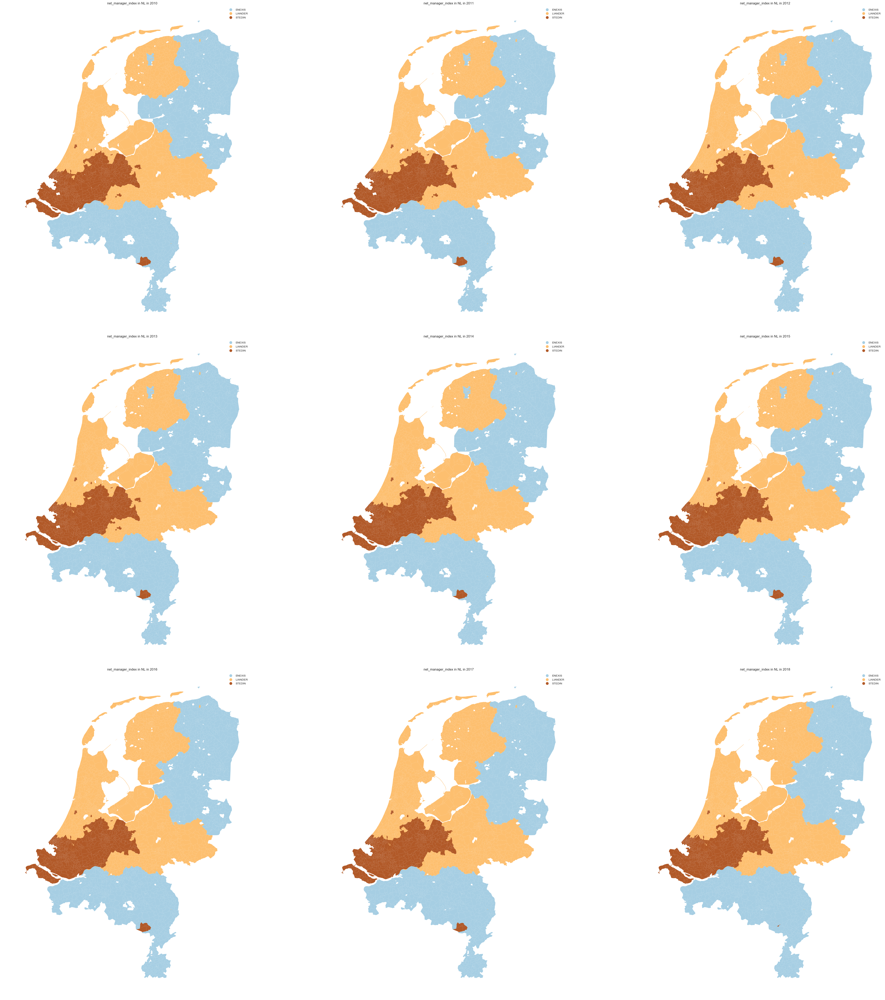

In [25]:
plot_on_map(merged_new, var, v_min, v_max, overlapping_years, categorical=True)

## Annual consumption in the zipcode range*

\* this is _NOT_ the 100% correct calculation of the consumption in the zipcode range. The consumption is aggregated based on the first 4 digits of the `zipcode_from`.

In [26]:
annual_consumption = (
    df_energy
    .groupby(['year', 'PC4', 'PC2'])
    .agg({'annual_consume': 'sum',
          'num_connections': 'sum'})
    .reset_index(inplace=False)
)

In [27]:
cols = map_df_pc4.columns.tolist()
merged = map_df_pc4[cols[:-1]].set_index('PC4').join(annual_consumption.set_index('PC4'))
merged_new = merged.fillna(0)

Then we will normalize the annual consumption by the area size

In [28]:
merged_new['norm_annual_consume'] = (
    merged_new.apply(lambda r: r['annual_consume']/r['Shape_Area'], axis=1)
)
v_min = merged_new['norm_annual_consume'].quantile(0.10) 
v_max = merged_new['norm_annual_consume'].quantile(0.90)

In [ ]:
# No need to set the cap for the metric to visualize 
# as in ploting you can choose different scheme (i.e. equal_interval, quantiles, fisher_jenks)
# to control the density of the visualization to avoid having ALL or NOTHING on the plot
# def adjust_value(r, c_min, c_max):
#     if r < c_min:
#         return c_min
#     elif r > c_max:
#         return c_max
#     else:
#         return r    

# var = 'norm_annual_consume_scale'
# merged_new[var] = (
#     merged_new['norm_annual_consume'].apply(lambda r: adjust_value(r, v_min, v_max))
# )
# merged_new[var] = (
#     merged_new['norm_annual_consume'].apply(lambda r: np.floor(r/1000)*1000)
# )

###### Annual electricity consumption normalized by area size

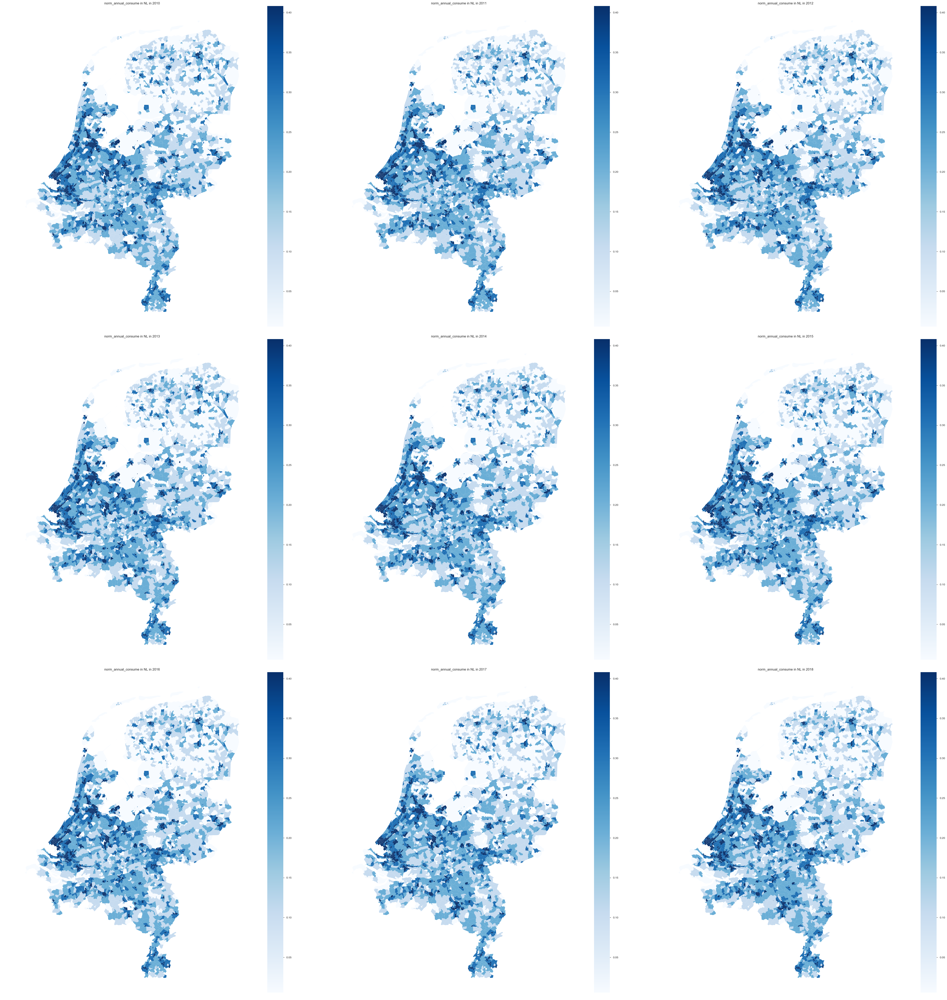

In [31]:
var = 'norm_annual_consume'
scheme = 'quantiles'
plot_on_map(merged_new, var, v_min, v_max, overlapping_years, scheme=scheme)

In [30]:
df = merged_new[['year', 'pc4txt', 'pc4_naam', var]]
print('Here is the list of neighbourhoods that per area consumed the most electricity per year:')
for y in overlapping_years:
    tmp = df[df['year']==y]
    print('- year', y, tmp.sort_values(by=[var], ascending=False).iloc[0, 2])

Here is the list of neighbourhoods that per area consumed the most electricity per year:
- year 2010 3012 Cool
- year 2011 3012 Cool
- year 2012 6421 Treebeek-zuid
- year 2013 6421 Treebeek-zuid
- year 2014 6421 Treebeek-zuid
- year 2015 1012 Burgwallen
- year 2016 1012 Burgwallen
- year 2017 1012 Burgwallen
- year 2018 1012 Burgwallen


Ha, that's beautiful.

I'm wondering who's using wayyyyyyy more energy than others. Can you do that?

###### Annual electricity consumption normalized by the number of connections

In [34]:
var = 'norm_annual_consume_connection'
merged_new['num_connections'] = merged_new['num_connections'].apply(lambda r: 1 if r < 1 else r)
merged_new[var] = (
    merged_new.apply(lambda r: r['annual_consume']/r['num_connections'], axis=1)
)
v_min = merged_new[var].quantile(0.05) 
v_max = merged_new[var].quantile(0.90)

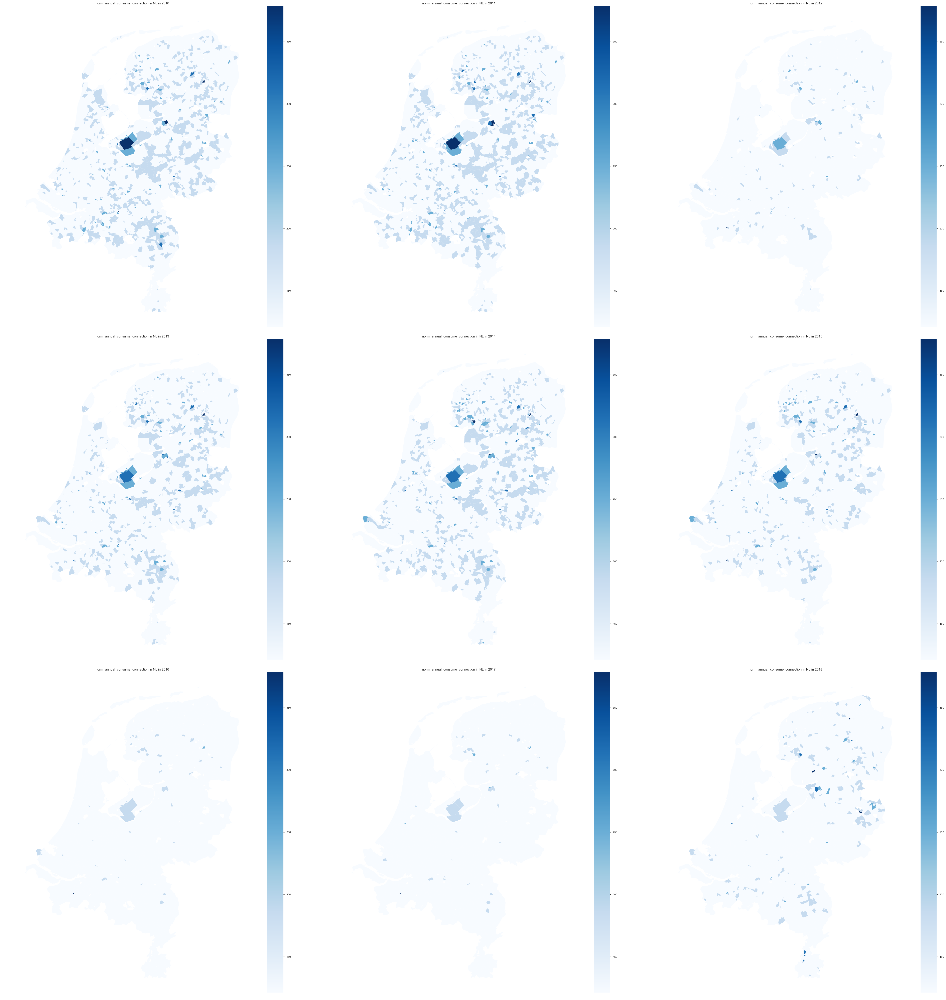

In [35]:
scheme = 'equal_interval'
plot_on_map(merged_new, var, v_min, v_max, overlapping_years, scheme)

In [36]:
df = merged_new[['year', 'pc4txt', 'pc4_naam', var]]
print('Here is the list of neighbourhoods that per connection consumed the most electricity per year:')
for y in overlapping_years:
    tmp = df[df['year']==y]
    print('- year', y, tmp.sort_values(by=[var], ascending=False).iloc[0, 2])

Here is the list of neighbourhoods that per connection consumed the most electricity per year:
- year 2010 3897 Middengebied
- year 2011 3897 Middengebied
- year 2012 4878 Industriegebied Vosdonk
- year 2013 9448 Marwijksoord
- year 2014 9448 Marwijksoord
- year 2015 4878 Industriegebied Vosdonk
- year 2016 4878 Industriegebied Vosdonk
- year 2017 4878 Industriegebied Vosdonk
- year 2018 9747 Universiteitscomplex


## Statistics on the region level* 

\*based on the first 2 digits of the zipcodes

Above figures are draw on the very granular level. Now let's turn into figures on the region level.

In [37]:
df_area = (
    df_energy.groupby(['PC2', 'year'])
    .agg(
        {
            'delivery_perc': 'mean',
            'num_connections': 'sum',
            'perc_of_active_connections': 'mean',
            'annual_consume': 'sum',
            'annual_consume_lowtarif_perc': 'mean',
            'smartmeter_perc': 'mean'
        }
    )
    .sort_values(by=['PC2'])
).reset_index(inplace=False)
df_area.columns = ['PC2', 'year', 'avg_delivery_perc',
                  'sum_num_connections', 'avg_perc_of_active_connections',
                  'sum_annual_consume', 'avg_annual_consume_lowtarif_perc','avg_smartmeter_perc']

In [38]:
merged_pc2 = (
    map_df_pc2.set_index('PC2')
    .join(
        df_area
        .drop_duplicates().set_index('PC2')
    )
)
merged_pc2 = merged_pc2.fillna(1)

In [39]:
merged_pc2['norm_annual_consume_connection'] = merged_pc2.apply(lambda r: r['sum_annual_consume']/r['sum_num_connections'], axis=1)
merged_pc2['norm_annual_consume_area'] = merged_pc2.apply(lambda r: r['sum_annual_consume']/r['Shape_Area'], axis=1)

###### Annual electricity consumption normalized by area size (on the __region__ level)

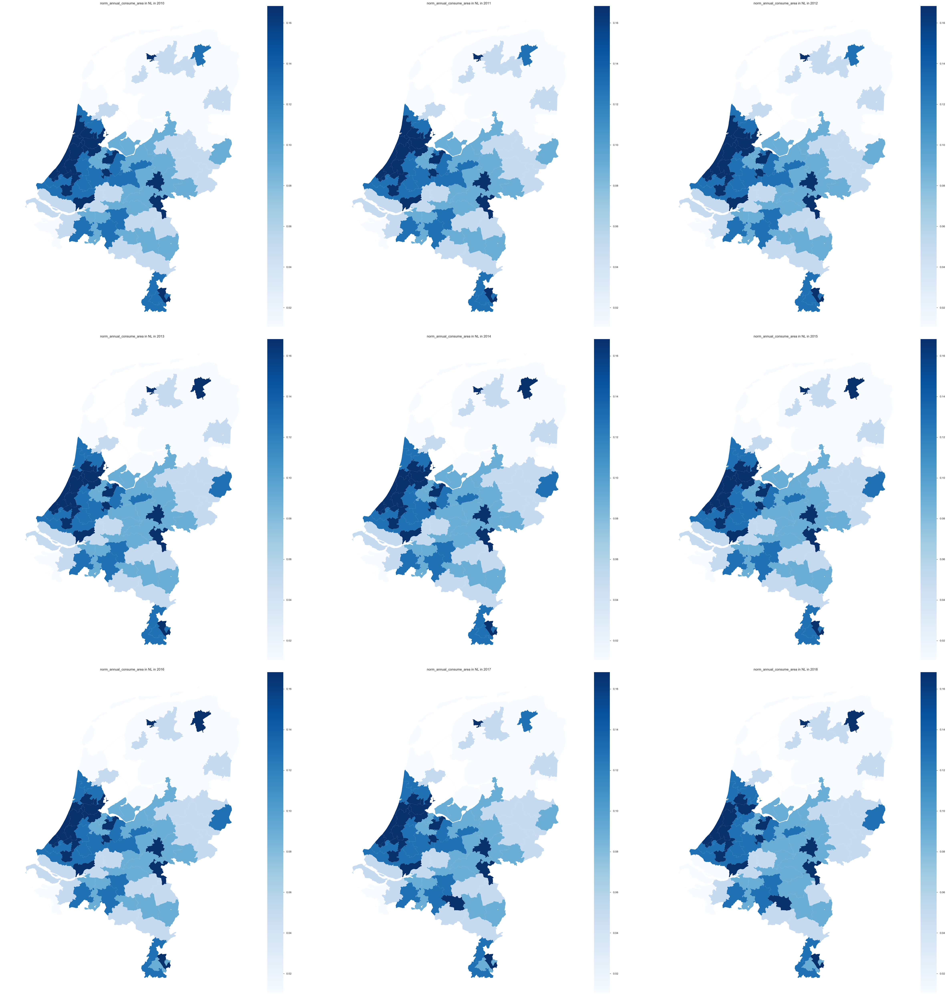

In [40]:
var = 'norm_annual_consume_area'
v_min = merged_pc2[var].quantile(0.05)
v_max = merged_pc2[var].quantile(0.95)
plot_on_map(merged_pc2, var, v_min, v_max, overlapping_years, scheme='quantiles')

###### Annual electricity consumption normalized by connections (on the region level)

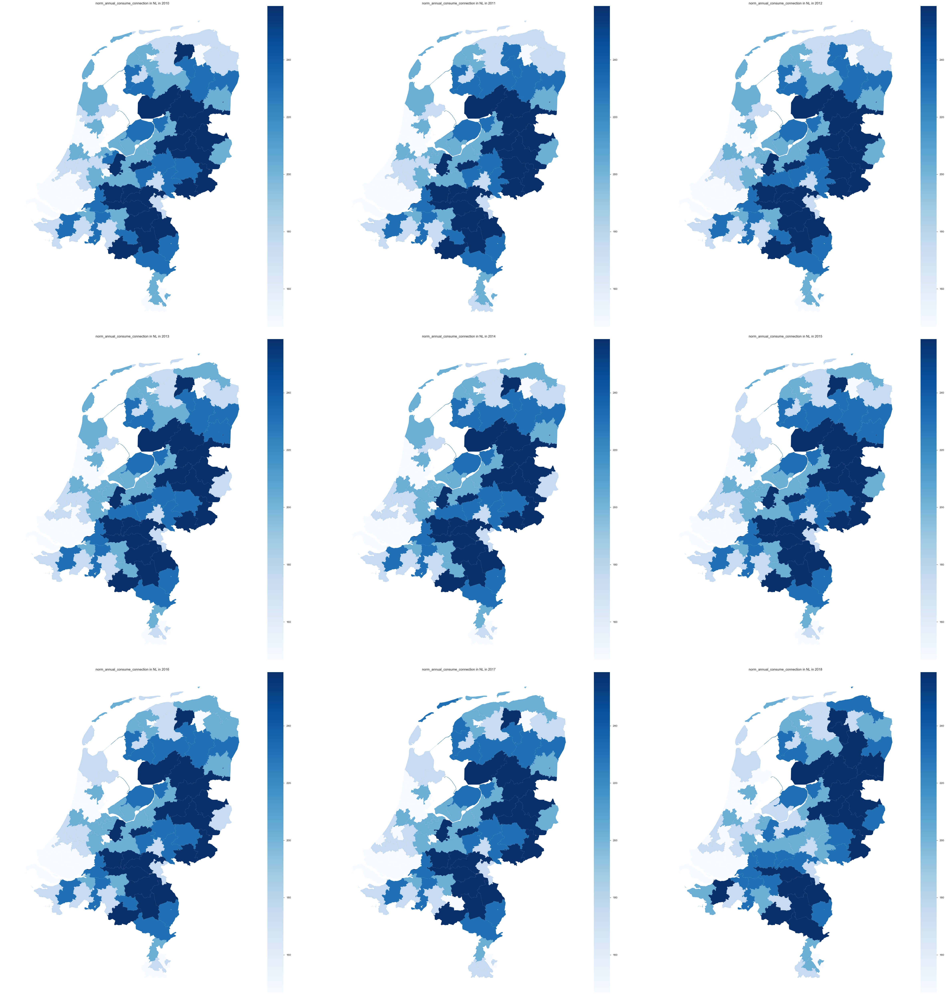

In [41]:
var = 'norm_annual_consume_connection'
v_min = merged_pc2[var].quantile(0.05)
v_max = merged_pc2[var].quantile(0.95)
plot_on_map(merged_pc2, var, v_min, v_max, overlapping_years, scheme='quantiles')

###### Average delivery percentage (on the region level)

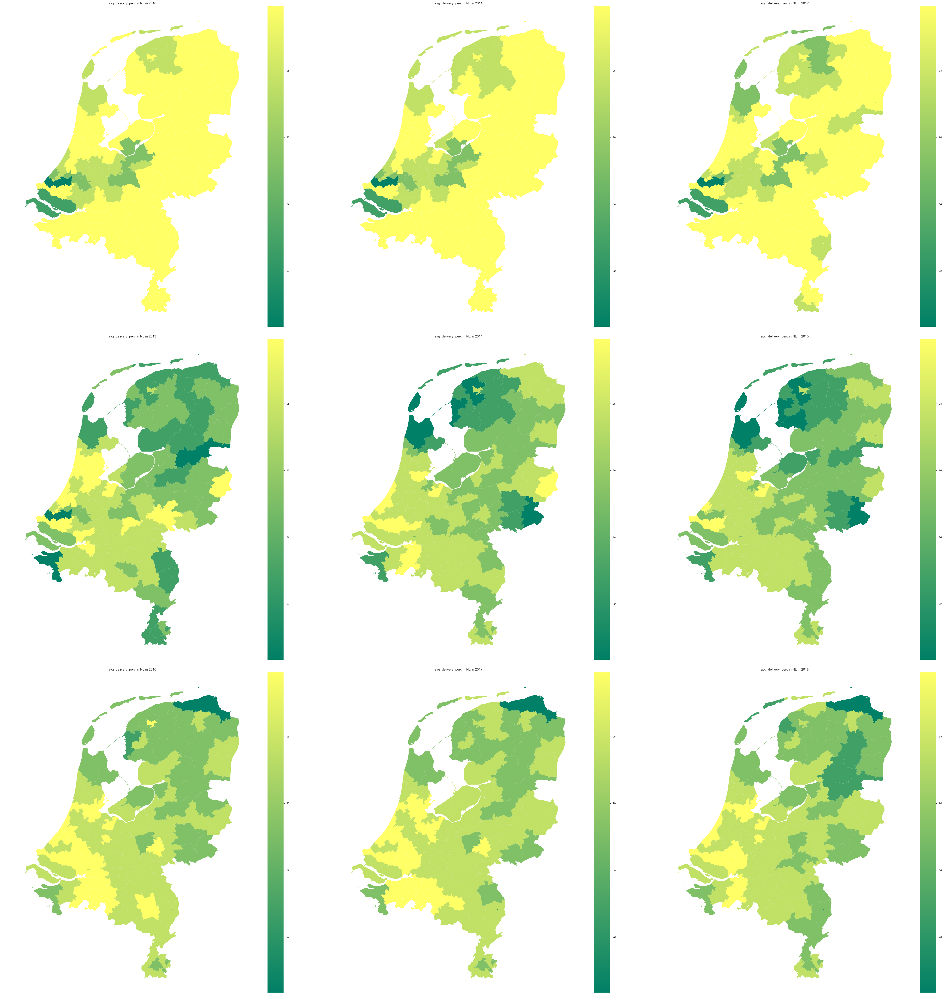

In [42]:
var = 'avg_delivery_perc'
v_min = merged_pc2[var].quantile(0.05)
v_max = merged_pc2[var].quantile(0.95)
color = 'summer'
plot_on_map(merged_pc2, var, v_min, v_max, overlapping_years, color=color)

###### Average percentage of active connections (on the region level)

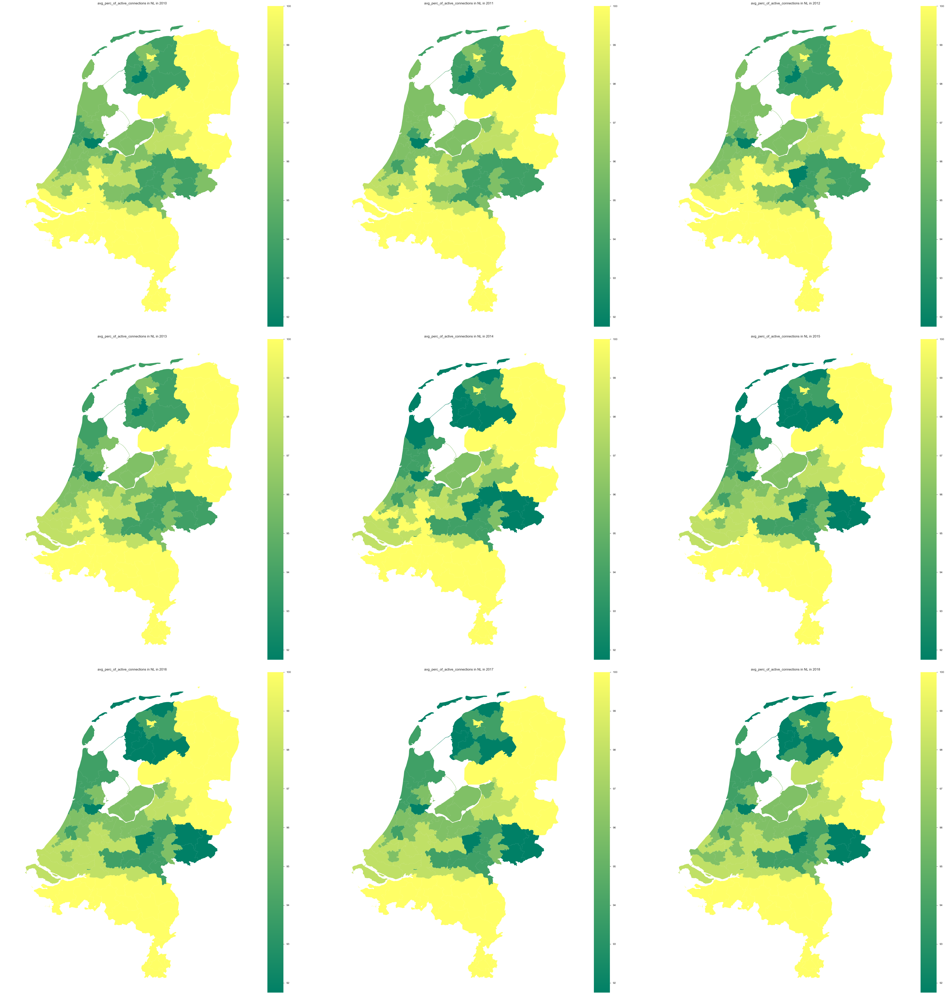

In [43]:
var = 'avg_perc_of_active_connections'
v_min = merged_pc2[var].quantile(0.05)
v_max = merged_pc2[var].quantile(0.95)
color = 'summer'
plot_on_map(merged_pc2, var, v_min, v_max, overlapping_years, color=color)

###### Average percentage of low tarif energy consume (on the region level)

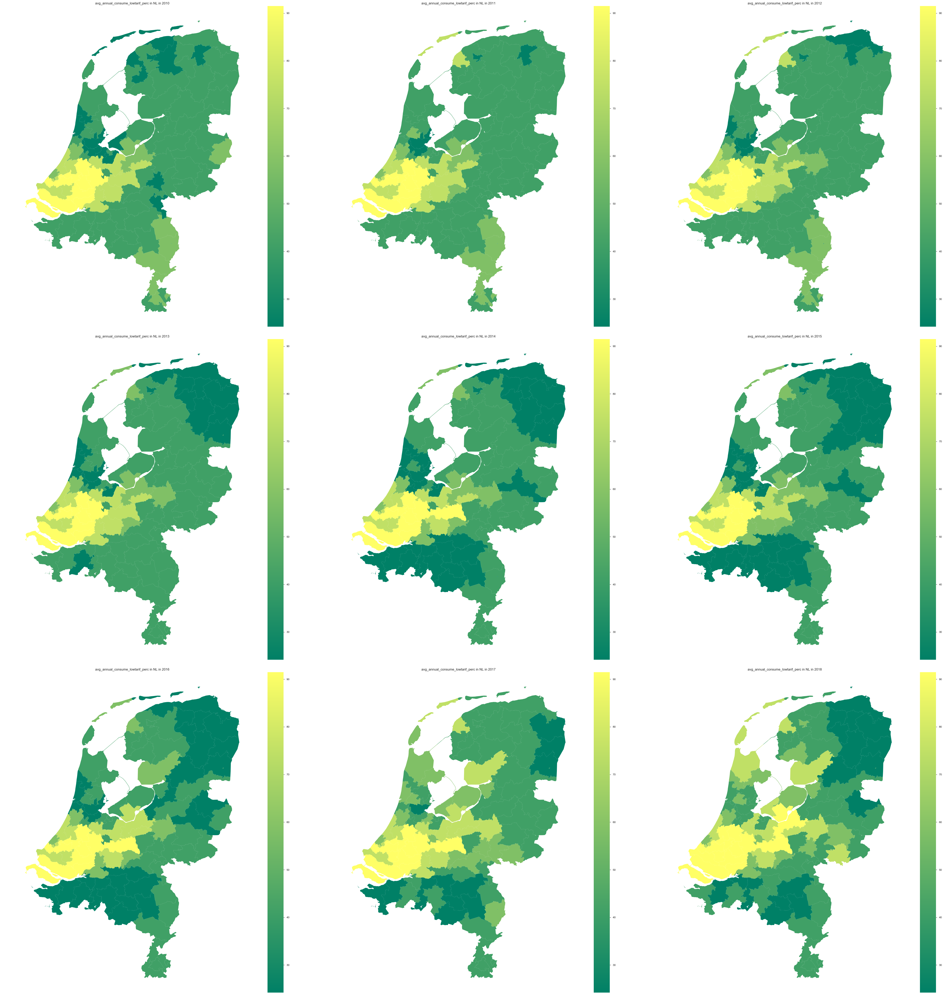

In [44]:
var = 'avg_annual_consume_lowtarif_perc'
v_min = merged_pc2[var].quantile(0.05)
v_max = merged_pc2[var].quantile(0.95)
color = 'summer'
plot_on_map(merged_pc2, var, v_min, v_max, overlapping_years, color=color)

###### Average percentage of smartmeters (on the region level)

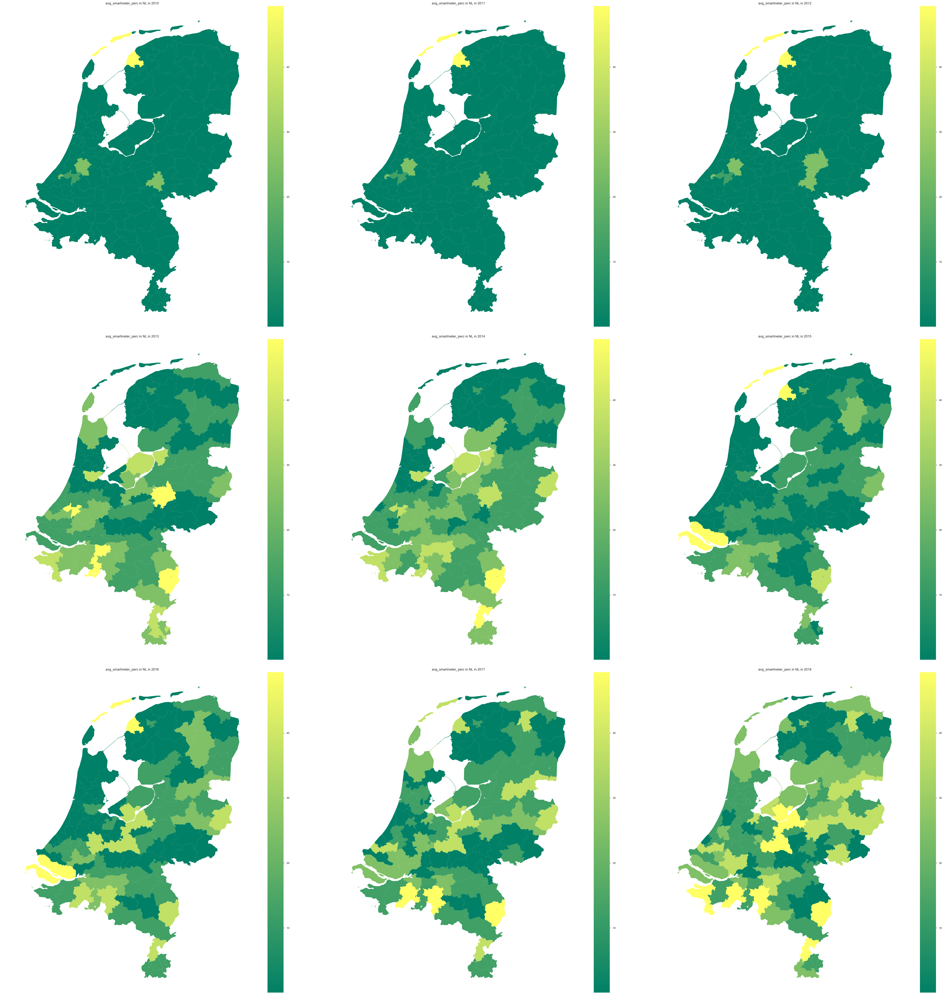

In [45]:
var = 'avg_smartmeter_perc'
v_min = merged_pc2[var].quantile(0.05)
v_max = merged_pc2[var].quantile(0.95)
color = 'summer'
plot_on_map(merged_pc2, var, v_min, v_max, overlapping_years, color=color)

### Time series

Map PC2 to city

In [ ]:
df_pc2_city = df_energy[['PC2', 'city']].drop_duplicates()
df_pc2_city.sort_values(by=['PC2'], inplace=True)

In [ ]:
var = 'avg_annual_consume_lowtarif_perc'
PC2 = 38
CITY = 'AMSTERDAM'
df = df_energy_plus_area[df_energy_plus_area['PC2']==PC2]
# df = df_energy_plus_area[df_energy_plus_area['city']==CITY]
metric = df[['year', var]].drop_duplicates()
metric.sort_values(by=['year'], inplace=True)

In [ ]:
xs = np.arange(1, len(metric)+1)
plt.figure(figsize=(10, 3))
plt.plot(xs, metric[var])
plt.xticks(xs, metric['year'])
plt.title("%s changes over years"%var)
plt.grid()
plt.show()